# Necessary Imports 

In [7]:
!git clone https://github.com/anishjv/cell-AAP.git

Cloning into 'cell-AAP'...
remote: Enumerating objects: 11076, done.
remote: Counting objects: 100% (300/300), done.
remote: Compressing objects: 100% (181/181), done.
remote: Total 11076 (delta 148), reused 253 (delta 102), pack-reused 10776
Receiving objects: 100% (11076/11076), 83.86 MiB | 53.24 MiB/s, done.
Resolving deltas: 100% (10799/10799), done.


In [1]:
%%capture
import numpy as np
import seaborn as sns
import tifffile as tiff
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
import os
import cv2
from scipy.stats import skew
import sys

%pip install Cython
%pip install hdbscan
%pip install umap-learn
%pip install umap-learn[plot]

import hdbscan
import umap
import umap.plot

%pip install torch torchvision torchaudio
import torch
import torchvision
import gc

%pip install git+https://github.com/facebookresearch/segment-anything.git
%pip install opencv-python pycocotools matplotlib onnxruntime onnx

In [2]:
%load_ext autoreload
%autoreload 2


import importlib  
au = importlib.import_module("cell-AAP.cell_AAP.annotation.annotation_utils")
sys.path.append('/home/anishjv/cell_seg_classify/notebooks/cell-AAP/cell_AAP/annotation/')
sys.path.append('/home/anishjv/cell_seg_classify/notebooks/cell-AAP/')
ann = importlib.import_module("cell-AAP.cell_AAP.annotation.annotator")
dw = importlib.import_module("cell-AAP.cell_AAP.annotation.dataset_write")
cfg = importlib.import_module("cell-AAP.cell_AAP.configs")

# Model Info
Here is where you define the SAM model to be used

In [3]:
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor
from segment_anything.modeling import Sam

#Code below should be run if file is not already saved in path 
#!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth

sam_checkpoint = "vit_l.pt"
model_type = "vit_l"
device = 'cuda'
sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device = device)
predictor = SamPredictor(sam)

# Object Oriented Dataset Creation 

In this notebook we will demonstrate usage of the **Annotator** class to automate dataset generation. Here dataset creation requires two steps.

1. Instantiate an instance of the **Cfg** class and call the class method **get_config** which defaults to the configurations for HeLA cells. 

2. Instantiate an instance of the **Annotator** class and call the class method **get**. The method takes 3 arguments 

    - 'configs', an instance of the Cfg class.
    - 'dna_image_list', list of dna stain microscopy tiff images 
    - 'phase_image_list', list of phase microscopy tiff images
         #
2. Call the methods **crop** and **gen_df** on the instance you instantiated in the last step

We can then use UMAP and HDBSCAN to find meaningful groupings within our dataset

In [4]:
configs = cfg.Cfg.get_config()
instance = ann.Annotator.get(configs,
                             ['/scratch/ajitj_root/ajitj99/anishjv/data_movies/dna.tif'],               
                             ['/scratch/ajitj_root/ajitj99/anishjv/data_movies/phase.tiff'], 
                            )

def sd_intensity(regionmask, intensity_image):
        return np.std(intensity_image[regionmask])
    
    
df = instance.crop(predictor=predictor).gen_df(extra_props = (sd_intensity,))
    
    

86.23092207255098
87.47684774296458
86.71318093074412
87.30770693059888
87.310751612832
85.73160441041998
85.53227356213498
85.88368025137414
85.12941779647855
85.98654186774043
83.64904494401542
84.50602648632923
84.57956048188663
84.44974561645623
86.08655705519317
84.22782768572036
83.88272709219316
83.156429823068
82.6982227264904
84.23567611144773
82.55793653159105


In [5]:
print("size of singular segmentation:", instance.segmentations[0][0].nbytes / 1e6)
print("size of singluar region:", instance.cleaned_binary_roi[0][0].nbytes / 1e6)
print("size of stored images:", (instance.phase_image_stack.nbytes + instance.dna_image_stack.nbytes) / 1e6)
print("size of dataframe:", df.nbytes / 1e6)


size of singular segmentation: 0.524288
size of singluar region: 0.029584
size of stored images: 352.321536
size of dataframe: 0.930528


# Computing the Metric



In [6]:
%%capture
metric_mapper = umap.UMAP(n_neighbors=50,
                   min_dist=0.0,
                   n_components=2,
                   random_state=42,).fit(df)

metric_embedding = umap.UMAP(n_neighbors=50,
                                  min_dist=0.0,
                                  n_components=2,
                                  random_state=42,
                                 ).fit_transform(df)


In [20]:
metric_labels = hdbscan.HDBSCAN(min_samples=5,
                         min_cluster_size = int( (1/50) * df.shape[0]),
                        ).fit_predict(metric_embedding)


for i in range(metric_labels.shape[0]):
    if metric_labels[i] in [2, 3, 4]:
        metric_labels[i] = 0
    elif metric_labels[i] != -1:
        metric_labels[i] = 1


df_metric = au.add_labels(df, metric_labels)


<Axes: >

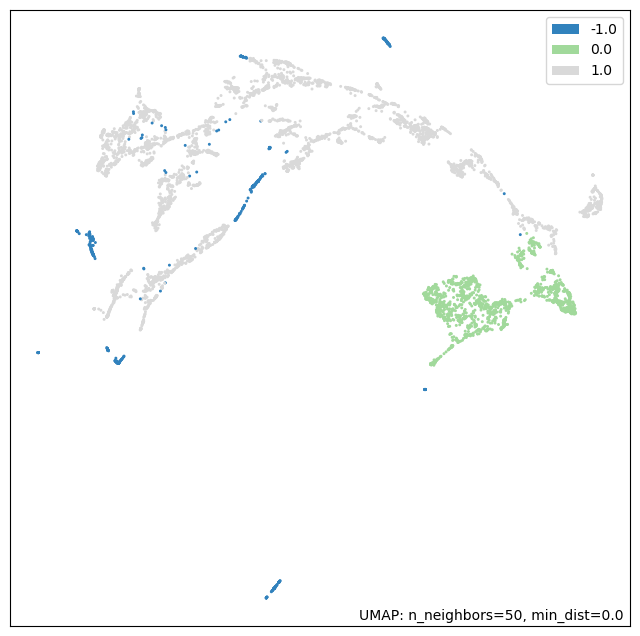

In [21]:
umap.plot.points(metric_mapper, labels = df_metric[:, -1], theme = 'green')

In [22]:
clusters = au.write_clusters(df_metric, -1)
cluster_0 = clusters[0]
cluster_1 = clusters[1]
cluster_noise = clusters['noise']

# Classification 

Below we display the results of cell classification by UMAP and HDBSCAN. Each code cell plots a sample of ROI's from one cluster. Each cluster has been created by UMAP and HDBSCAN in a way such that ROI's within the same cluster share similar properties. 

**Cluster 0**

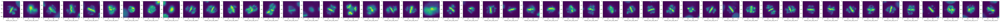

In [23]:
fig, ax = plt.subplots(ncols = 50, figsize = (150,200))

for i in range(50):
    ax[i].imshow(instance.roi[int(cluster_0[-i, 0])][int(cluster_0[-i, 1])])
    ax[i].set_xlabel(f'Frame_{cluster_0[-i, 0]}_cell_{cluster_0[-i, 1]}')

plt.show()

**Cluster 1**

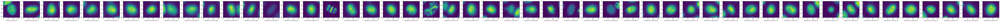

In [24]:
fig, ax = plt.subplots(ncols = 50, figsize = (150,100))

for i in range(50):
    ax[i].imshow(instance.roi[int(cluster_1[-i, 0])][int(cluster_1[-i, 1])])
    ax[i].set_xlabel(f'Frame_{cluster_1[-i, 0]}_cell_{cluster_1[-i, 1]}')

plt.show()

In [ ]:
np.save('/home/anishjv/cell_seg_classify/metricdf_HeLa.npy', df_metric, allow_pickle = False )
np.save('/home/anishjv/cell_seg_classify/metriclabels_HeLa.npy', metric_labels, allow_pickle = False)

# Or use a pre-computed metric

In [4]:
df_metric = np.load('/home/anishjv/cell_seg_classify/metricdf_HeLa.npy')
metric_labels = np.load('/home/anishjv/cell_seg_classify/metriclabels_HeLa.npy')

# SAM (Segment Anything Model)

We will now display the automatically generated cell segmentations produced by SAM, these segmentations can be used to train a specialized network algorithm. 

In [5]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)
    
    
def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))
    

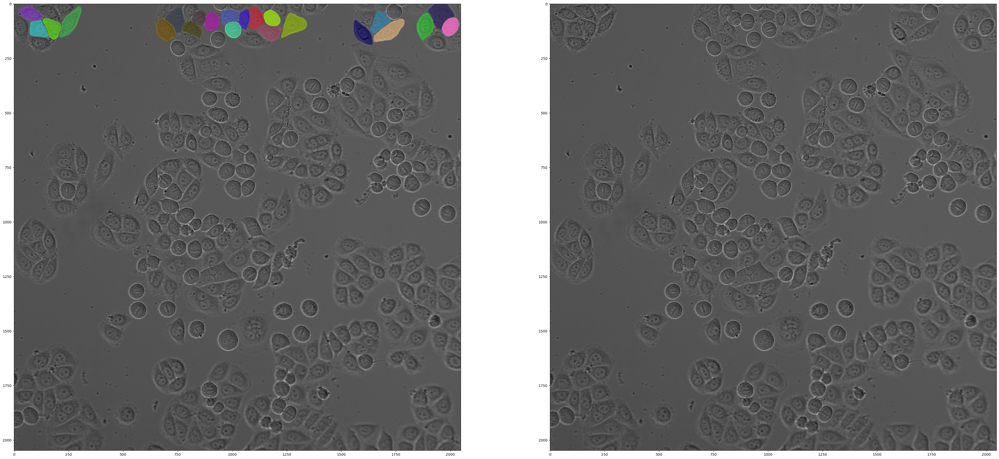

In [35]:
fig, ax = plt.subplots(ncols = 2, figsize = (50,50))

ax[0].imshow(au.bw_to_rgb(instance.phase_image_stack[1]))
ax[1].imshow(au.bw_to_rgb(instance.phase_image_stack[1]))
for i in range(25):
    mask = np.unpackbits(instance.segmentations[1][i], axis = 0, count = 2048)
    mask = np.array([mask])
    show_mask(mask, ax[0], random_color = True)

plt.show()

# Metric Learning

Above we created a dataset and classified it's contents with high accuracy. We will now treat these classification labels as if they are the gound truth in a procees called, 'metric learning'. 

In [50]:
%%time
configs = cfg.Cfg.get_config()
configs.frame_step = 36

def sd_intensity(regionmask, intensity_image):
        return np.std(intensity_image[regionmask])

instance_whole = ann.Annotator.get(configs,
                      [
                       '/scratch/ajitj_root/ajitj99/anishjv/data_movies/20221006_red_uncalibrated_D12_1.tif', 
                       '/scratch/ajitj_root/ajitj99/anishjv/data_movies/20221006_red_uncalibrated_E12_1.tif',
                       '/scratch/ajitj_root/ajitj99/anishjv/data_movies/20221006_red_uncalibrated_F12_1.tif',
                       '/scratch/ajitj_root/ajitj99/anishjv/data_movies/20221006_red_uncalibrated_A12_1.tif',
                       ],               
                      [
                       '/scratch/ajitj_root/ajitj99/anishjv/data_movies/20221006_D12_1.tif',
                       '/scratch/ajitj_root/ajitj99/anishjv/data_movies/20221006_E12_1.tif',
                       '/scratch/ajitj_root/ajitj99/anishjv/data_movies/20221006_F12_1.tif',
                       '/scratch/ajitj_root/ajitj99/anishjv/data_movies/20221006_A12_1.tif',
                      ]
                     )

df_whole = instance_whole.crop(predictor = predictor).gen_df(extra_props = (sd_intensity,))

85.89921210573065
82.70213177335793
77.1977905905222
74.52722168507836
75.15113366663711
88.72841830252682
85.09572262404895
80.89942633812201
77.21596796452296
80.31194484376945
84.34360501660181
80.85980240942511
74.77396742444346
74.72068026457079
77.09655809454677
76.25802312286899
72.850571743815
66.60141271050534
64.73355647432133
65.68877641739407
CPU times: user 8min 25s, sys: 11.5 s, total: 8min 36s
Wall time: 9min 55s


In [52]:
metric_mapper_2 = umap.UMAP(n_neighbors=50,
                            random_state = 42
                           ).fit(df_metric[:, 0:-1], 
                                  np.expand_dims(metric_labels, axis = 1))

test_embedding = metric_mapper_2.transform(df_whole,
                                          )

/home/anishjv/.local/lib/python3.10/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [53]:
labels_whole_embedding = hdbscan.HDBSCAN(min_samples=10,
                                        min_cluster_size = int((1/10) * df_whole.shape[0]),
                                        ).fit_predict(test_embedding)

df_whole_labeled = au.add_labels(df_whole, labels_whole_embedding)

In [54]:
clusters = au.write_clusters(df_whole_labeled, -1)
cluster_0_test = clusters[0]
cluster_1_test = clusters[1]
cluster_2_test = clusters[2]
cluster_dud_test = clusters['noise']

for cluster in clusters.values():
    print(cluster.shape)

(1431, 2)
(3559, 2)
(4509, 2)
(3145, 2)


**Mitotic**

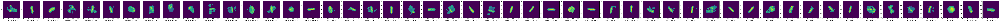

In [55]:
fig, ax = plt.subplots(ncols = 50, figsize = (150,150))

for i in range(50):
    ax[i].imshow(instance_whole.cleaned_scalar_roi[int(clusters[0][i, 0])][int(clusters[0][i, 1])])
    ax[i].set_xlabel(f'Frame_{clusters[0][i, 0]}_cell_{clusters[0][i, 1]}')

plt.show()

**Non-Mitotic**

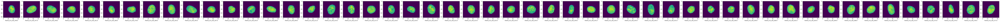

In [56]:
fig, ax = plt.subplots(ncols = 50, figsize = (150,150))

for i in range(50):
    ax[i].imshow(instance_whole.cleaned_scalar_roi[int(clusters[1][i, 0])][int(clusters[1][i, 1])])
    ax[i].set_xlabel(f'Frame_{clusters[1][i, 0]}_cell_{clusters[1][i, 1]}')

plt.show()

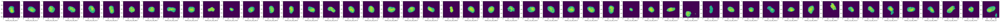

In [57]:
fig, ax = plt.subplots(ncols = 50, figsize = (150,150))

for i in range(50):
    ax[i].imshow(instance_whole.cleaned_scalar_roi[int(clusters[2][i, 0])][int(clusters[2][i, 1])])
    ax[i].set_xlabel(f'Frame_{clusters[2][i, 0]}_cell_{clusters[2][i, 1]}')

plt.show()

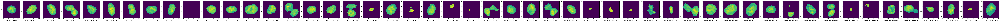

In [60]:
fig, ax = plt.subplots(ncols = 50, figsize = (150,150))

for i in range(50):
    ax[i].imshow(instance_whole.cleaned_scalar_roi[int(clusters['noise'][i, 0])][int(clusters['noise'][i, 1])])
    ax[i].set_xlabel(f'Frame_{clusters["noise"][i, 0]}_cell_{clusters["noise"][i, 1]}')

plt.show()

Note above that HDBSCAN spat out more than 2 clusters, in this case you must display the cluster and decifer which are mitotic, and which are non-mitotic. Here we see that HDBSCAN found 3 different clusters of non-mitotic cells that differ in size. 

In [61]:
for i in range(df_whole_labeled.shape[0]):
    if df_whole_labeled[i, -1] in [2, -1]:
        df_whole_labeled[i, -1] = 1

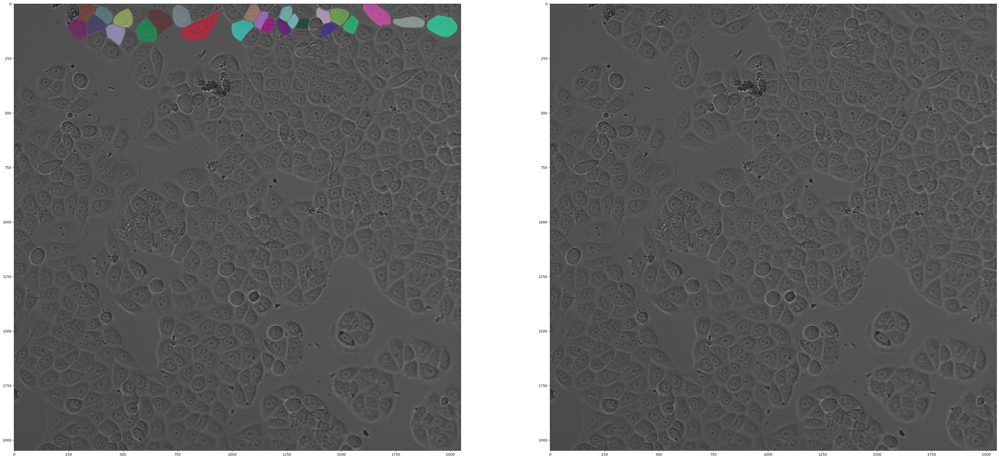

In [63]:
fig, ax = plt.subplots(ncols = 2, figsize = (50,50))

ax[0].imshow(au.bw_to_rgb(instance_whole.phase_image_stack[10]))
ax[1].imshow(au.bw_to_rgb(instance_whole.phase_image_stack[10]))
for i in range(25):
    mask = np.unpackbits(instance_whole.segmentations[10][i], axis = 0, count = 2048)
    mask = np.array([mask])
    show_mask(mask, ax[0], random_color = True)

plt.show()

# Displaying "fuzzy" data

If $D$, the DNA stain image is over exposed or low resolution, the following may occur

In [37]:
instance_fuzz_data = dt.ROI.get(props_list,
                      ['/home/anishjv/cell_seg_classify/data/20221216_red_uncalibrated_C9_1.tif'],               
                      ['/home/anishjv/cell_seg_classify/data/20221216_C9_1.tif'],
                      roi_size = 40, 
                      frame_step = 6
                     )

df_fuzz_data = instance_fuzz_data.crop(threshold_division = 4, sigma = 3, segment = False).gen_df(extra_props = (sd_intensity,))

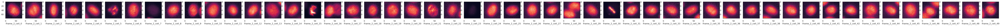

In [38]:
fig, ax = plt.subplots(ncols = 50, figsize = (100,100))

for i in range(50):
    ax[i].imshow(instance_fuzz_data.roi[f'Frame_2_cell_{i}'])
    ax[i].set_xlabel(f'Frame_2_cell_{i}')

# Balancing the Dataset

Above you may have noticed that df_whole contains some extreme class imbalance $\approx
$ 14,000 non-mitotic vs. $\approx$ 3,000 mitotic. 

We'll aim to fix that issue by creating extra annotations from an experiment where HeLa cells were treated with GSK (a drug that challenged cell division and leads to a prolonged metaphase arrest). 

We follow the standard protocol here of "1 experiment, 1 metric". Since this experiment differs from the experiment used to generate the data contained in df_whole, we will not attempt to use our previous metric

In [64]:
configs = cfg.Cfg.get_config()
configs.frame_step = 1
configs.threshold_type = 'multi'

instance_gsk = ann.Annotator.get(configs, 
                                         [
                                             '/scratch/ajitj_root/ajitj99/anishjv/data_movies/mCh.tif'
                                         ],
                                          [
                                              '/scratch/ajitj_root/ajitj99/anishjv/data_movies/20221216_CyclinB-GSK_CDH_105.tif'
                                          ]
                                         )

df_gsk = instance_gsk.crop(predictor = predictor).gen_df(extra_props = (sd_intensity, ))

89.98929396271713
85.92878520627951
98.1131347506091
74.07227182920968
84.11295131539748
82.5952554660207
81.78319373424144
100.8032080510468
90.58563371604168
90.29016173207299
99.22546387543301
97.2799043784714
89.18693530022355
80.98733965048353


In [65]:
gsk_mapper = umap.UMAP(n_neighbors=50,
                   min_dist=0.0,
                   n_components=2,
                   random_state=42,).fit(df_gsk)

gsk_embedding = umap.UMAP(n_neighbors=50,
                                  min_dist=0.0,
                                  n_components=2,
                                  random_state=42,
                                 ).fit_transform(df_gsk)


/home/anishjv/.local/lib/python3.10/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/anishjv/.local/lib/python3.10/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [67]:
gsk_labels = hdbscan.HDBSCAN(min_samples=5,
                         min_cluster_size = int( (1/50) * df_gsk.shape[0]),
                        ).fit_predict(gsk_embedding)




df_gsk_labeled = au.add_labels(df_gsk, gsk_labels)


<Axes: >

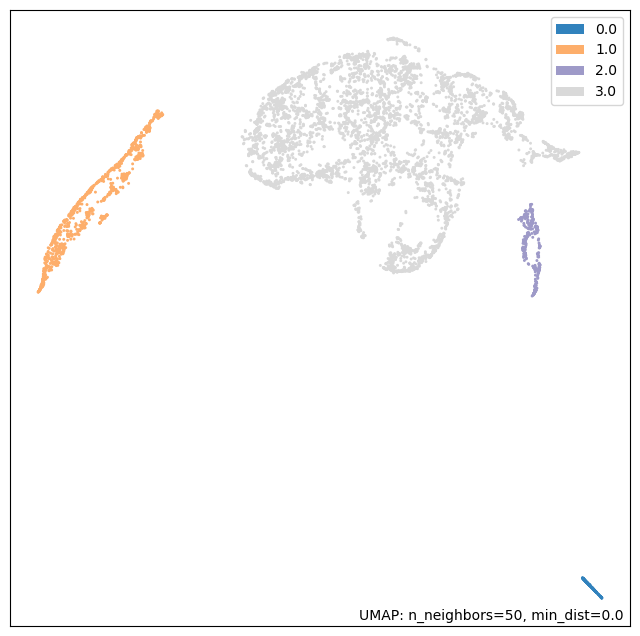

In [68]:
umap.plot.points(gsk_mapper, labels = df_gsk_labeled[:, -1], theme = 'green')

In [70]:
clusters = au.write_clusters(df_gsk_labeled, -1)


for cluster in clusters.values():
    print(cluster.shape)

(202, 2)
(1100, 2)
(376, 2)
(5237, 2)
(0, 2)


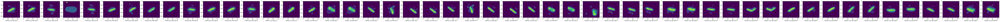

In [73]:
fig, ax = plt.subplots(ncols = 50, figsize = (150,150))

for i in range(50):
    ax[i].imshow(instance_gsk.cleaned_scalar_roi[int(clusters[0][i, 0])][int(clusters[0][i, 1])])
    ax[i].set_xlabel(f'Frame_{clusters[0][i, 0]}_cell_{clusters[0][i, 1]}')

plt.show()

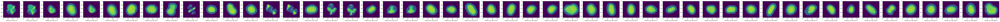

In [74]:
fig, ax = plt.subplots(ncols = 50, figsize = (150,150))

for i in range(50):
    ax[i].imshow(instance_gsk.cleaned_scalar_roi[int(clusters[1][i, 0])][int(clusters[1][i, 1])])
    ax[i].set_xlabel(f'Frame_{clusters[1][i, 0]}_cell_{clusters[1][i, 1]}')

plt.show()

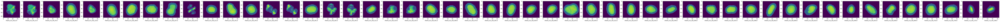

In [75]:
fig, ax = plt.subplots(ncols = 50, figsize = (150,150))

for i in range(50):
    ax[i].imshow(instance_gsk.cleaned_scalar_roi[int(clusters[2][i, 0])][int(clusters[1][i, 1])])
    ax[i].set_xlabel(f'Frame_{clusters[2][i, 0]}_cell_{clusters[2][i, 1]}')

plt.show()

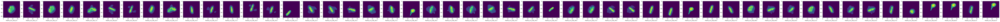

In [76]:
fig, ax = plt.subplots(ncols = 50, figsize = (150,150))

for i in range(50):
    ax[i].imshow(instance_gsk.cleaned_scalar_roi[int(clusters[3][i, 0])][int(clusters[3][i, 1])])
    ax[i].set_xlabel(f'Frame_{clusters[3][i, 0]}_cell_{clusters[3][i, 1]}')

plt.show()

Note above that HDBSCAN has again spat out more than 2 clusters, in this case you must display the cluster and decifer which are mitotic, and which are non-mitotic. Here we see that HDBSCAN found 3 different clusters of non-mitotic cells that differ in size. 

In [77]:
for i in range(df_gsk_labeled.shape[0]):
    if df_gsk_labeled[i, -1] in [3, 0]:
        df_gsk_labeled[i, -1] = 0
    else:
        df_gsk_labeled[i, -1] = 1

# Writing a Dataset

We provide functionality within the module "dataset_write.py" to write a dataset that can be further converted to coco-format by running the script "dataset_convert.py"

In [167]:
phase_image_stack = np.concatenate(
    (instance_whole.phase_image_stack,
    instance_gsk.phase_image_stack),
    axis = 0
)


segmentations = np.concatenate(
    (instance_whole.segmentations, 
    instance_gsk.segmentations), 
    axis = 0
)

df_gsk_labeled[:, -3] += 40 #adjusting the frame number of df_gsk to avoid duplication
df_final_labeled = np.concatenate(
    (df_whole_labeled, df_gsk_labeled),
    axis = 0
)

dw.write_coco_conv_dataset(
    '/home/anishjv/cell_seg_classify/',
    phase_image_stack,
    segmentations,
    df_final_labeled,
    'coco_conv_dataset_1.9',
    {0: 'mitotic', 1: 'nonmitotic'}
)

IndexError: list index out of range

# Writing Files / Extracting UMAP coordinates

A breif aside on saving the annotations you have just generated in various formats

In [ ]:
def write_roi_jpg_by_frame(parent_dir, roi, 
                           umap_embedding, data_labels, 
                           frame_count, cell_count, 
                           name, pad_size = 60, text = True):
    '''
    Saves each ROI as a .jpg file containing it's UMAP coordinates and and Cluster
    ------------------------------------------------------------------------------
    INPUTS:
        parent_dir: string, parent directory where sub directories are to be made
        roi: dict: dictionary containing ROI images as n-darrays
        umap_embedding: n-darray, (N, 2) array containing coordinates for each data point of the umap embeddng
        data_labels: n-darray, array containing cluster labels for each data point
        frame_count: int, number of frames from which ROIs were cropped
        cell_count: dict, dictionary containing the number of cells on each frame, keys are of the form 'Frame_i'
        pad_size: int, pixel width of border to add to each ROI
    
    '''
    
    main_path = os.path.join(parent_dir, name)
    os.mkdir(main_path)
    total_cell_count = 0
    
    for i in range(frame_count):
        frame_path = os.path.join(main_path, f'frame_{i}')
        os.mkdir(frame_path)
        os.chdir(frame_path)
        
        for j in range(cell_count[f'Frame_{i}']):
            if total_cell_count < umap_embedding.shape[0]:
                
                text_line_1 = ' EC:' + str(umap_embedding[total_cell_count])
                text_line_2 = '\n Cluster: ' + str(data_labels[total_cell_count, -1])
                
                img = cv2.copyMakeBorder(
                    roi[f'Frame_{int(data_labels[total_cell_count, -3])}_cell_{int(data_labels[total_cell_count, -2])}'], 
                    pad_size, pad_size, pad_size, pad_size, 
                    cv2.BORDER_CONSTANT)
                
                img = Image.fromarray(dt.bw_to_rgb(img))
                
                if text == True:
                    img_e = ImageDraw.Draw(img)
                    img_e.text((10,10), 
                               text_line_1 + text_line_2, 
                               fill=255)
                
                img.save(f"Frame_{int(data_labels[total_cell_count, -3])}_cell_{int(data_labels[total_cell_count, -2])}.jpg")
                
                total_cell_count += 1
                

            

In [ ]:
def write_roi_jpg_by_cluster(parent_dir, roi, 
                             umap_embedding, data_labels, 
                             frame_count, cell_count, 
                             name, pad_size = 60, text = True):
    
    '''
    Saves each ROI as a .jpg file containing it's UMAP coordinates and and Cluster
    ------------------------------------------------------------------------------
    INPUTS:
        parent_dir: string, parent directory where sub directories are to be made
        roi: dict: dictionary containing ROI images as n-darrays
        umap_embedding: n-darray, (N, 2) array containing coordinates for each data point of the umap embeddng
        data_labels: n-darray, array containing cluster labels for each data point
        frame_count: int, number of frames from which ROIs were cropped
        cell_count: dict, dictionary containing the number of cells on each frame, keys are of the form 'Frame_i'
        pad_size: int, pixel width of border to add to each ROI
    
    '''
    
    main_path = os.path.join(parent_dir, name)
    os.mkdir(main_path)
    total_cell_count = 0
    
    for i in range( int(data_labels[:, -1].max() + 1) ):
        cluster_path = os.path.join(main_path, f'cluster_{i}')
        os.mkdir(cluster_path)
    
    for k in range(frame_count):
        for j in range(cell_count[f'Frame_{k}']):
            if total_cell_count < umap_embedding.shape[0]:

                text_line_1 = ' EC:' + str(umap_embedding[total_cell_count])
                text_line_2 = '\n Cluster: ' + str(data_labels[total_cell_count, -1])

                img = cv2.copyMakeBorder(
                    roi[f'Frame_{int(data_labels[total_cell_count, -3])}_cell_{int(data_labels[total_cell_count, -2])}'], 
                    pad_size, pad_size, pad_size, pad_size, 
                    cv2.BORDER_CONSTANT)

                img = Image.fromarray(dt.bw_to_rgb(img))

                if text == True:
                    img_e = ImageDraw.Draw(img)
                    img_e.text((10,10), 
                               text_line_1 + text_line_2, 
                               fill=255)

                if data_labels[total_cell_count, -1] == 0:
                    cluster_0_path = os.path.join(main_path, 'cluster_0')
                    os.chdir(cluster_0_path)
                elif data_labels[total_cell_count, -1] == 1:
                    cluster_1_path = os.path.join(main_path, 'cluster_1')
                    os.chdir(cluster_1_path)
                elif data_labels[total_cell_count, -1] == 2:
                    cluster_2_path = os.path.join(main_path, 'cluster_2')
                    os.chdir(cluster_2_path)


                img.save(f"Frame_{int(data_labels[total_cell_count, -3])}_cell_{int(data_labels[total_cell_count, -2])}.jpg")

                total_cell_count += 1
                
